# AVOCADO AVERAGE PRICE CASE STUDY

## Problem Statement:

This data was downloaded from the Hass Avocado Board website in May of 2018 & compiled into a single CSV. 
The table below represents weekly 2018 retail scan data for National retail volume (units) and price. Retail scan data comes directly from retailers’ cash registers based on actual retail sales of Hass avocados. 
Starting in 2013, the table below reflects an expanded, multi-outlet retail data set. Multi-outlet reporting includes an aggregation of the following channels: grocery, mass, club, drug, dollar and military. The Average Price (of avocados) in the table reflects a per unit (per avocado) cost, even when multiple units (avocados) are sold in bags. 
The Product Lookup codes (PLU’s) in the table are only for Hass avocados. Other varieties of avocados (e.g. greenskins) are not included in this table.

Task here is to make a mode that can consider the data provided and predict the Average Price.


### Features

•	Date - The date of the observation

•	AveragePrice - the average price of a single avocado

•	type - conventional or organic

•	year - the year

•	Region - the city or region of the observation

•	Total Volume - Total number of avocados sold

•	4046 - Total number of avocados with PLU 4046 sold

•	4225 - Total number of avocados with PLU 4225 sold

•	4770 - Total number of avocados with PLU 4770 sold


## Importing Libraries

In [508]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stat
from scipy.stats import zscore
from sklearn.linear_model import LinearRegression
from sklearn.naive_bayes import MultinomialNB,GaussianNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.preprocessing import LabelEncoder
import xgboost
from xgboost import XGBRegressor
from sklearn.metrics import accuracy_score,classification_report,confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.metrics import roc_curve,roc_auc_score
from sklearn.metrics import r2_score,mean_squared_error,mean_absolute_error
import joblib
import warnings
warnings.filterwarnings('ignore')
pd.set_option('display.max_rows', None) # to see all the rows
pd.set_option('display.max_columns', None) # to see all the columns

## Importing and exploring the dataset

In [509]:
Avocado=pd.read_csv('Avacado.csv')
Avocado

,Unnamed: 0,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
0,0,27-12-2015,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.00,conventional,2015,Albany
1,1,20-12-2015,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.00,conventional,2015,Albany
2,2,13-12-2015,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.00,conventional,2015,Albany
3,3,06-12-2015,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.00,conventional,2015,Albany
4,4,29-11-2015,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.00,conventional,2015,Albany
5,5,22-11-2015,1.26,55979.78,1184.27,48067.99,43.61,6683.91,6556.47,127.44,0.00,conventional,2015,Albany
6,6,15-11-2015,0.99,83453.76,1368.92,73672.72,93.26,8318.86,8196.81,122.05,0.00,conventional,2015,Albany
7,7,08-11-2015,0.98,109428.33,703.75,101815.36,80.00,6829.22,6266.85,562.37,0.00,conventional,2015,Albany
8,8,01-11-2015,1.02,99811.42,1022.15,87315.57,85.34,11388.36,11104.53,283.83,0.00,conventional,2015,Albany
9,9,25-10-2015,1.07,74338.76,842.40,64757.44,113.00,8625.92,8061.47,564.45,0.00,conventional,2015,Albany


In [510]:
Avocado.shape

(1517, 14)

Avocado dataset have 1517 rows and 14 columns.

In [511]:
Avocado.head()

,Unnamed: 0,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
0,0,27-12-2015,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0,conventional,2015,Albany
1,1,20-12-2015,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0,conventional,2015,Albany
2,2,13-12-2015,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0,conventional,2015,Albany
3,3,06-12-2015,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0,conventional,2015,Albany
4,4,29-11-2015,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0,conventional,2015,Albany


First five rows of the dataset.

In [512]:
Avocado.tail()

,Unnamed: 0,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
1512,10,16-10-2016,1.39,190846.01,57529.11,56366.66,17531.78,59418.46,48823.53,10354.65,240.28,conventional,2016,Charlotte
1513,11,09-10-2016,1.51,178235.75,43325.87,52189.61,19419.57,63300.70,54704.14,8596.56,0.00,conventional,2016,Charlotte
1514,12,02-10-2016,1.48,178410.82,46364.75,52893.38,16736.92,62415.77,53332.61,8258.16,825.00,conventional,2016,Charlotte
1515,13,25-09-2016,1.47,189131.52,54110.79,53593.58,17495.42,63931.73,55653.47,8278.26,0.00,conventional,2016,Charlotte
1516,14,18-09-2016,1.43,182978.30,43116.41,54193.42,16563.91,69104.56,57456.21,11648.35,0.00,conventional,2016,Charlotte


Bottom five rows of the dataset.

In [513]:
Avocado.isnull().sum()

Unnamed: 0      0
Date            0
AveragePrice    0
Total Volume    0
4046            0
4225            0
4770            0
Total Bags      0
Small Bags      0
Large Bags      0
XLarge Bags     0
type            0
year            0
region          0
dtype: int64

There are no null values in the dataset.

In [514]:
Avocado.dtypes

Unnamed: 0        int64
Date             object
AveragePrice    float64
Total Volume    float64
4046            float64
4225            float64
4770            float64
Total Bags      float64
Small Bags      float64
Large Bags      float64
XLarge Bags     float64
type             object
year              int64
region           object
dtype: object

This dataset has 2 int, 3 object and 9 float type columns.

In [515]:
Avocado.columns

Index(['Unnamed: 0', 'Date', 'AveragePrice', 'Total Volume', '4046', '4225',
       '4770', 'Total Bags', 'Small Bags', 'Large Bags', 'XLarge Bags', 'type',
       'year', 'region'],
      dtype='object')

Aboce are the column names in this dataset.

In [516]:
Avocado.describe()

,Unnamed: 0,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,year
count,1517.000000,1517.000000,1.517000e+03,1.517000e+03,1.517000e+03,1.517000e+03,1.517000e+03,1.517000e+03,1.517000e+03,1517.000000,1517.000000
mean,26.995386,1.074990,1.601879e+06,6.464387e+05,6.114375e+05,5.040550e+04,2.935974e+05,2.487736e+05,4.264205e+04,2181.771074,2015.162821
std,14.848287,0.188891,4.433143e+06,1.947614e+06,1.672906e+06,1.377812e+05,7.579765e+05,6.474765e+05,1.182157e+05,7455.712144,0.369324
min,0.000000,0.490000,3.875074e+04,4.677200e+02,1.783770e+03,0.000000e+00,3.311770e+03,3.311770e+03,0.000000e+00,0.000000,2015.000000
25%,14.000000,0.980000,1.474700e+05,2.040034e+04,4.147606e+04,9.112500e+02,3.620689e+04,2.972722e+04,5.407400e+02,0.000000,2015.000000
50%,29.000000,1.080000,4.027919e+05,8.175117e+04,1.186649e+05,7.688170e+03,7.397906e+04,6.237569e+04,5.044350e+03,0.000000,2015.000000
75%,39.000000,1.190000,9.819751e+05,3.775785e+05,4.851503e+05,2.916730e+04,1.576097e+05,1.461994e+05,2.926767e+04,401.480000,2015.000000
max,51.000000,1.680000,4.465546e+07,1.893304e+07,1.895648e+07,1.381516e+06,6.736304e+06,5.893642e+06,1.121076e+06,108072.790000,2016.000000


In [517]:
# get year from the corresponding 
# Date column value
Avocado['year'] = pd.DatetimeIndex(Avocado['Date']).year

In [518]:
# get month from the corresponding 
Avocado['month'] = pd.DatetimeIndex(Avocado['Date']).month

In [519]:
Avocado

,Unnamed: 0,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region,month
0,0,27-12-2015,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.00,conventional,2015,Albany,12
1,1,20-12-2015,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.00,conventional,2015,Albany,12
2,2,13-12-2015,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.00,conventional,2015,Albany,12
3,3,06-12-2015,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.00,conventional,2015,Albany,6
4,4,29-11-2015,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.00,conventional,2015,Albany,11
5,5,22-11-2015,1.26,55979.78,1184.27,48067.99,43.61,6683.91,6556.47,127.44,0.00,conventional,2015,Albany,11
6,6,15-11-2015,0.99,83453.76,1368.92,73672.72,93.26,8318.86,8196.81,122.05,0.00,conventional,2015,Albany,11
7,7,08-11-2015,0.98,109428.33,703.75,101815.36,80.00,6829.22,6266.85,562.37,0.00,conventional,2015,Albany,8
8,8,01-11-2015,1.02,99811.42,1022.15,87315.57,85.34,11388.36,11104.53,283.83,0.00,conventional,2015,Albany,1
9,9,25-10-2015,1.07,74338.76,842.40,64757.44,113.00,8625.92,8061.47,564.45,0.00,conventional,2015,Albany,10


In [520]:
Avocado.shape

(1517, 15)

In [521]:
#drop the  column date from avocado dataset as we have month and year as new attributes.

In [522]:
Avocado.drop(['Date'],axis=1,inplace=True)

In [523]:
#drop the column Unnamed:0 as this after overlooking the data in this column we can conclude that data is irrelavant.

In [524]:
Avocado.drop(['Unnamed: 0'],axis=1,inplace=True)

In [525]:
#Avocado dataset after dropping thd Date and Unnamed column.
Avocado

,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region,month
0,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.00,conventional,2015,Albany,12
1,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.00,conventional,2015,Albany,12
2,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.00,conventional,2015,Albany,12
3,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.00,conventional,2015,Albany,6
4,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.00,conventional,2015,Albany,11
5,1.26,55979.78,1184.27,48067.99,43.61,6683.91,6556.47,127.44,0.00,conventional,2015,Albany,11
6,0.99,83453.76,1368.92,73672.72,93.26,8318.86,8196.81,122.05,0.00,conventional,2015,Albany,11
7,0.98,109428.33,703.75,101815.36,80.00,6829.22,6266.85,562.37,0.00,conventional,2015,Albany,8
8,1.02,99811.42,1022.15,87315.57,85.34,11388.36,11104.53,283.83,0.00,conventional,2015,Albany,1
9,1.07,74338.76,842.40,64757.44,113.00,8625.92,8061.47,564.45,0.00,conventional,2015,Albany,10


In [526]:
# check the unique values in categorized columns type,year,region

In [527]:
Avocado['type'].unique()

array(['conventional'], dtype=object)

In [528]:
Avocado['type'].value_counts()

conventional    1517
Name: type, dtype: int64

There is only type of avocado in this dataset i.e conventional.

In [529]:
#check for year

In [530]:
Avocado['year'].unique()

array([2015, 2016], dtype=int64)

In [531]:
Avocado['year'].value_counts()

2015    1270
2016     247
Name: year, dtype: int64

Dataset has data about avocado for years 2015 and 2016.
There is more data about avocados from year 2015.

In [532]:
#check for region.

In [533]:
Avocado['region'].unique()

array(['Albany', 'Atlanta', 'BaltimoreWashington', 'Boise', 'Boston',
       'BuffaloRochester', 'California', 'Charlotte', 'Chicago',
       'Columbus', 'DallasFtWorth', 'Denver', 'Detroit', 'GrandRapids',
       'GreatLakes', 'HarrisburgScranton', 'HartfordSpringfield',
       'Houston', 'Indianapolis', 'Jacksonville', 'LasVegas',
       'LosAngeles', 'Louisville', 'MiamiFtLauderdale', 'Midsouth',
       'Nashville', 'NewYork', 'Northeast', 'NorthernNewEngland',
       'Orlando', 'Philadelphia', 'PhoenixTucson', 'Pittsburgh', 'Plains',
       'Portland', 'RaleighGreensboro', 'RichmondNorfolk', 'Roanoke',
       'SanDiego', 'SanFrancisco', 'Seattle', 'SouthCarolina',
       'SouthCentral', 'Southeast', 'Spokane', 'StLouis', 'Syracuse',
       'Tampa', 'TotalUS', 'West', 'WestTexNewMexico'], dtype=object)

In [534]:
Avocado['region'].value_counts()

California             76
Albany                 67
BaltimoreWashington    65
Boise                  65
Boston                 62
Atlanta                54
PhoenixTucson          52
BuffaloRochester       51
Spokane                49
Columbus               47
NewYork                44
Jacksonville           41
Detroit                40
SouthCentral           39
SanDiego               38
West                   36
Louisville             34
Tampa                  34
Charlotte              31
Portland               30
Houston                29
NorthernNewEngland     29
WestTexNewMexico       27
TotalUS                25
Nashville              25
SouthCarolina          24
Denver                 24
GrandRapids            23
Chicago                23
Pittsburgh             22
RichmondNorfolk        21
Orlando                21
Syracuse               19
HarrisburgScranton     19
Midsouth               18
GreatLakes             18
Roanoke                17
MiamiFtLauderdale      17
DallasFtWort

There are total 52 regions in the dataset.

## Correlation

In [535]:
Avocado.corr()

,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,year,month
AveragePrice,1.000000,-0.140470,-0.190096,-0.092084,-0.100567,-0.111597,-0.097682,-0.177480,-0.048284,0.178683,0.060642
Total Volume,-0.140470,1.000000,0.985568,0.987154,0.934347,0.967689,0.960642,0.910226,0.521717,-0.004189,-0.055212
4046,-0.190096,0.985568,1.000000,0.951952,0.898570,0.930395,0.922278,0.884229,0.474063,-0.040439,-0.053007
4225,-0.092084,0.987154,0.951952,1.000000,0.927757,0.951779,0.943988,0.900496,0.504718,-0.007254,-0.058429
4770,-0.100567,0.934347,0.898570,0.927757,1.000000,0.926405,0.923607,0.840523,0.646053,0.029222,-0.055079
Total Bags,-0.111597,0.967689,0.930395,0.951779,0.926405,1.000000,0.997341,0.911336,0.601856,0.090108,-0.047747
Small Bags,-0.097682,0.960642,0.922278,0.943988,0.923607,0.997341,1.000000,0.879131,0.611300,0.106382,-0.048978
Large Bags,-0.177480,0.910226,0.884229,0.900496,0.840523,0.911336,0.879131,1.000000,0.447779,-0.018678,-0.039242
XLarge Bags,-0.048284,0.521717,0.474063,0.504718,0.646053,0.601856,0.611300,0.447779,1.000000,0.218342,0.021452
year,0.178683,-0.004189,-0.040439,-0.007254,0.029222,0.090108,0.106382,-0.018678,0.218342,1.000000,-0.013144


Table defines the correlation of the columns in avocado dataset.

In [536]:
#Coorelation with heatmap.

<AxesSubplot:>

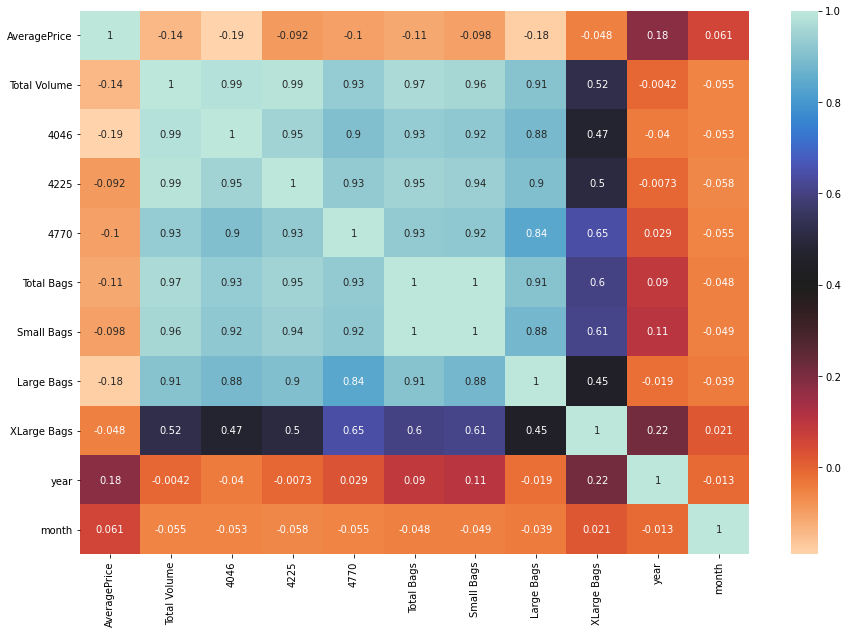

In [537]:
plt.figure(figsize=(15,10))
sns.heatmap(Avocado.corr(),annot=True,cmap='icefire_r')

Obseervation:
    
1)Total bags and small bags have the highest positive correlation.

2)PLU 4046 is very highly correlated with total volume.

3)Total Bags is very highly correlated with total volume.

4)PLU 4025 is very highly correlated with total volume.

5)PLU 4770, Small bags and Large bags are also highly correlated with total volume.

6)Large bags,PLU 4046 are negatively correlated with Average price.

### Top 10 correlated values

In [538]:
correlation_0=Avocado.corr().abs().unstack().sort_values(kind='quicksort').dropna()
correlation_0

Total Volume  year            0.004189
year          Total Volume    0.004189
              4225            0.007254
4225          year            0.007254
month         year            0.013144
year          month           0.013144
Large Bags    year            0.018678
year          Large Bags      0.018678
month         XLarge Bags     0.021452
XLarge Bags   month           0.021452
4770          year            0.029222
year          4770            0.029222
month         Large Bags      0.039242
Large Bags    month           0.039242
year          4046            0.040439
4046          year            0.040439
Total Bags    month           0.047747
month         Total Bags      0.047747
XLarge Bags   AveragePrice    0.048284
AveragePrice  XLarge Bags     0.048284
Small Bags    month           0.048978
month         Small Bags      0.048978
4046          month           0.053007
month         4046            0.053007
              4770            0.055079
4770          month      

In [539]:
correlation_0=correlation_0[correlation_0!=1]
correlation_0

Total Volume  year            0.004189
year          Total Volume    0.004189
              4225            0.007254
4225          year            0.007254
month         year            0.013144
year          month           0.013144
Large Bags    year            0.018678
year          Large Bags      0.018678
month         XLarge Bags     0.021452
XLarge Bags   month           0.021452
4770          year            0.029222
year          4770            0.029222
month         Large Bags      0.039242
Large Bags    month           0.039242
year          4046            0.040439
4046          year            0.040439
Total Bags    month           0.047747
month         Total Bags      0.047747
XLarge Bags   AveragePrice    0.048284
AveragePrice  XLarge Bags     0.048284
Small Bags    month           0.048978
month         Small Bags      0.048978
4046          month           0.053007
month         4046            0.053007
              4770            0.055079
4770          month      

In [540]:
correlation_0_Top10=correlation_0.tail(10)
correlation_0_Top10

Small Bags    Total Volume    0.960642
Total Volume  Small Bags      0.960642
              Total Bags      0.967689
Total Bags    Total Volume    0.967689
4046          Total Volume    0.985568
Total Volume  4046            0.985568
              4225            0.987154
4225          Total Volume    0.987154
Small Bags    Total Bags      0.997341
Total Bags    Small Bags      0.997341
dtype: float64

Above are top 10 highly correlated columns

## Exploratory Data Analysis

### Univariate Analysis

In [541]:
Avocado.columns

Index(['AveragePrice', 'Total Volume', '4046', '4225', '4770', 'Total Bags',
       'Small Bags', 'Large Bags', 'XLarge Bags', 'type', 'year', 'region',
       'month'],
      dtype='object')

<AxesSubplot:xlabel='AveragePrice'>

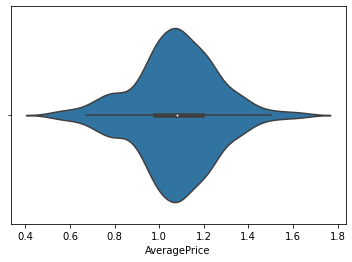

In [542]:
sns.violinplot(Avocado['AveragePrice'])

Observstion:
    
Averagre price of per unit avocado usualy range from 0.8 to 1.4.    

<AxesSubplot:xlabel='year'>

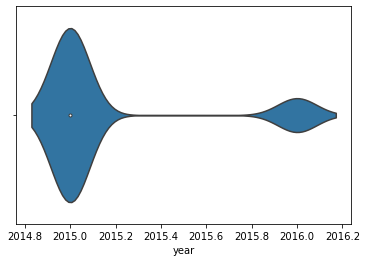

In [543]:
sns.violinplot(Avocado['year'])

There is more data availbale of avocados fro year 2015 compared to 2016.

<AxesSubplot:xlabel='count', ylabel='region'>

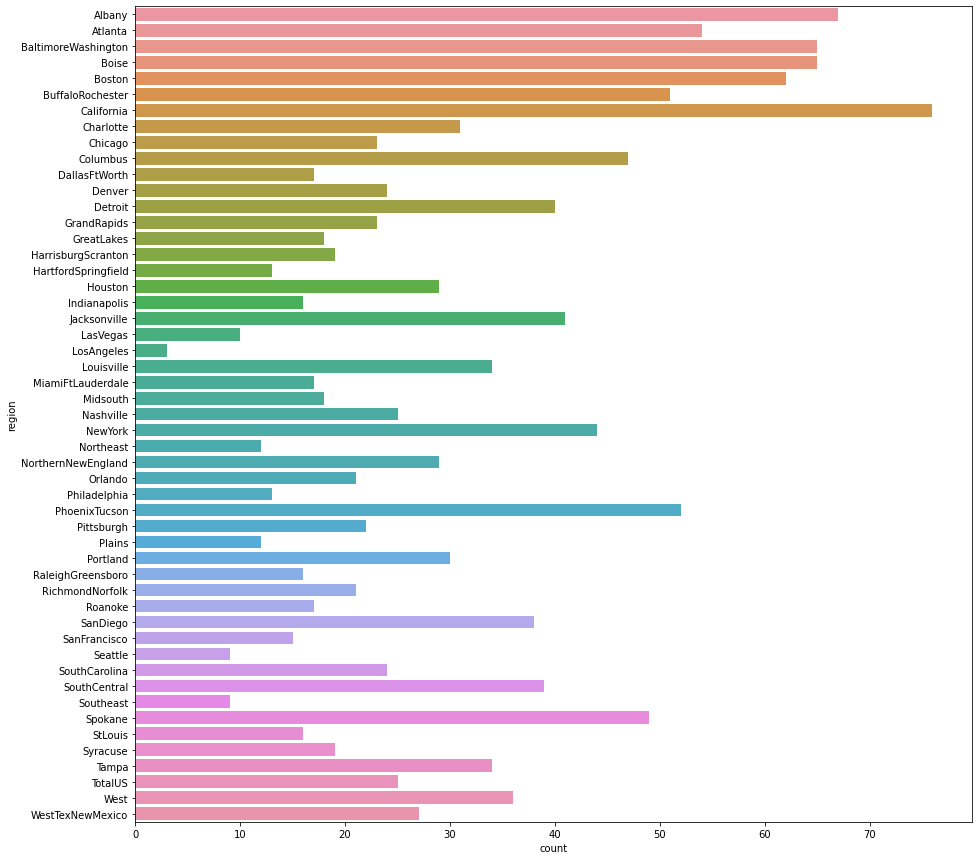

In [544]:
plt.figure(figsize=(15,15))
sns.countplot(y=Avocado['region'])

We have more data availbale from California,Albany,Atlanta,BaltimoreWashington,boston.

We have very less data available from seattle,Southeast,LosAngeles,LasVegas.

<AxesSubplot:xlabel='month', ylabel='count'>

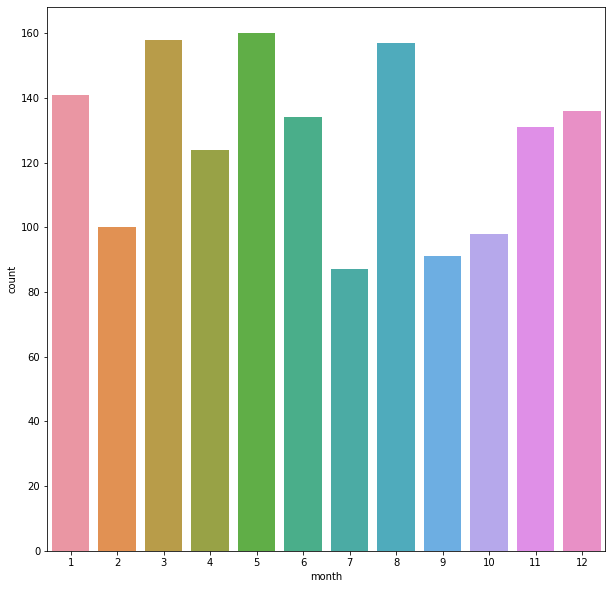

In [545]:
plt.figure(figsize=(10,10))
sns.countplot(Avocado['month'])

Very less data is availbale from month july and september.

We have more data from month of Jan,March,May and August.

<AxesSubplot:xlabel='year', ylabel='count'>

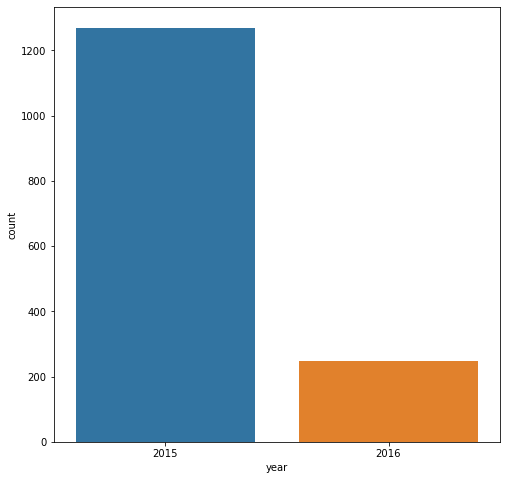

In [546]:
plt.figure(figsize=(8,8))
sns.countplot(Avocado['year'])

80% of data in this dataset is from year 2015 .

### Bivariate Analysis

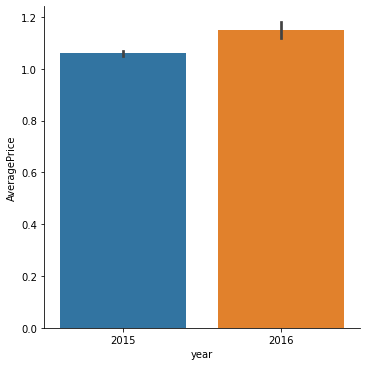

In [547]:
sns.catplot(y='AveragePrice',x='year',data=Avocado,kind='bar')
plt.show()

Average price of each avocado is higer in year 2016 as compare to 2015.


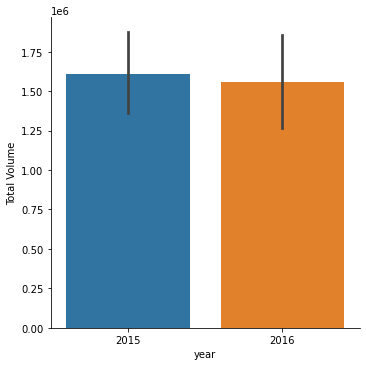

In [548]:
sns.catplot(y='Total Volume',x='year',data=Avocado,kind='bar')
plt.show()

Total volume is higher in year 2015 compare to 2016.

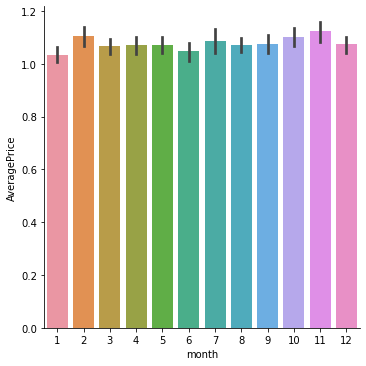

In [549]:
sns.catplot(y='AveragePrice',x='month',data=Avocado,kind='bar')
plt.show()

Average price of avocasdo is less in month of june and jan.

Average price is high in month of Feb and November.

Average price keep on increasing from august to november.

Average price is similar in month of march april and may.

<AxesSubplot:xlabel='AveragePrice', ylabel='region'>

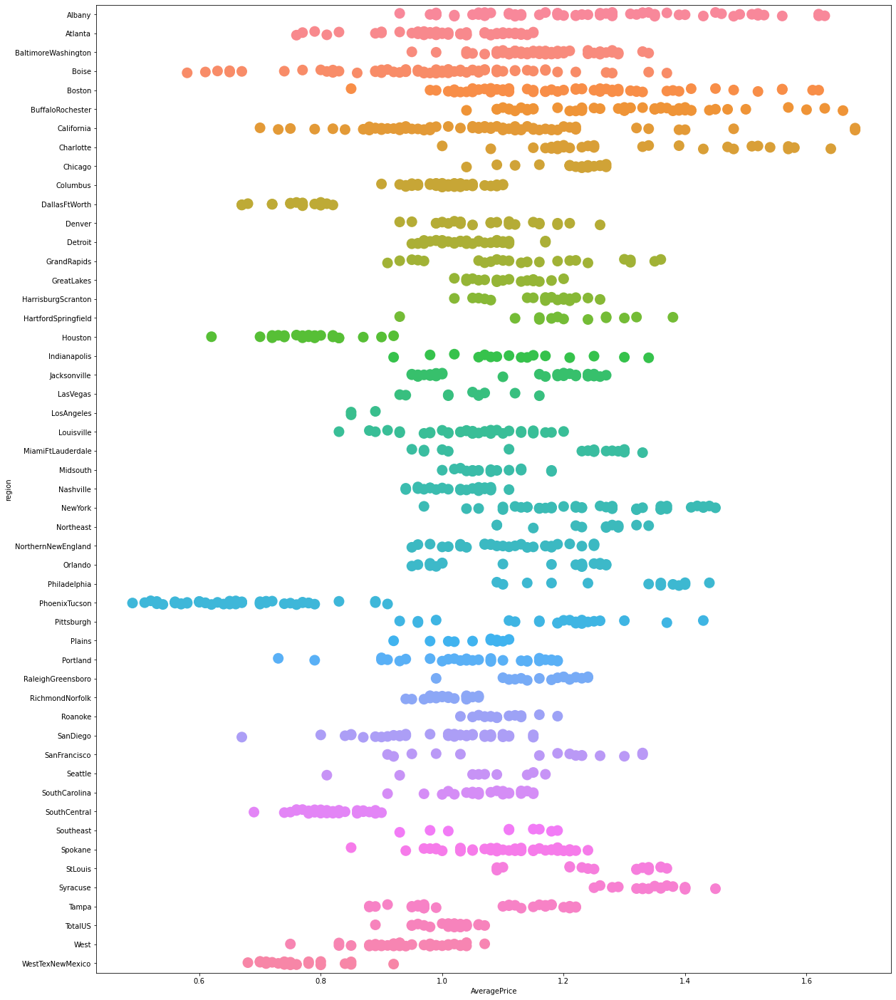

In [550]:
plt.figure(figsize=(20,25))
sns.stripplot(y='region',x='AveragePrice',data=Avocado,size=15)

Average price is more in  California,Albany,Atlanta,BaltimoreWashington,boston.

Average price is least in phoenix Tuscon region compared to other regions.

Avergae price usualy range from 0.8 to 1.2 in most of the regions.

<AxesSubplot:xlabel='year', ylabel='region'>

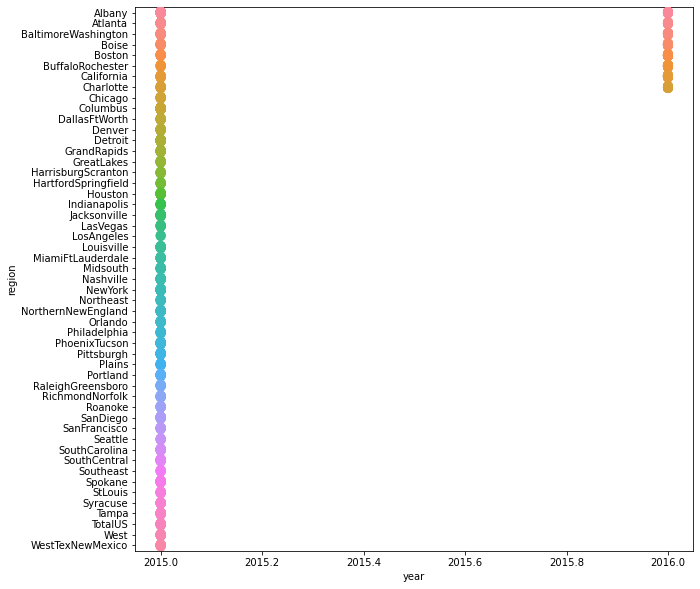

In [551]:
plt.figure(figsize=(10,10))
sns.stripplot(y='region',x='year',data=Avocado,size=10)

Data for avocado in year 2016 is avaliable for regions albany,atlanta,boise,boston,california,buffalorocheseter,baltimorewashington

<AxesSubplot:xlabel='Total Volume', ylabel='Total Bags'>

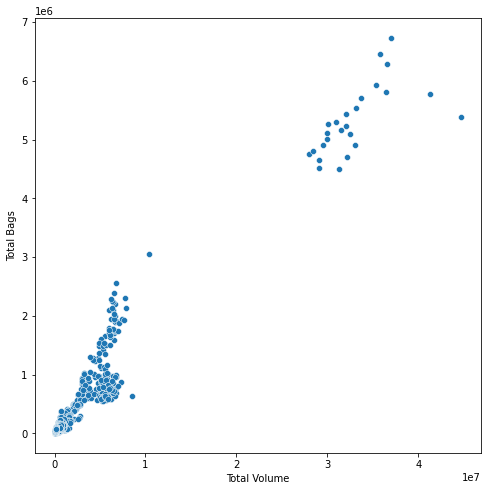

In [552]:
plt.figure(figsize=(8,8))
sns.scatterplot(y='Total Bags',x='Total Volume',data=Avocado)

Total volume and Total bags are positively correlated.

<AxesSubplot:xlabel='month', ylabel='Total Bags'>

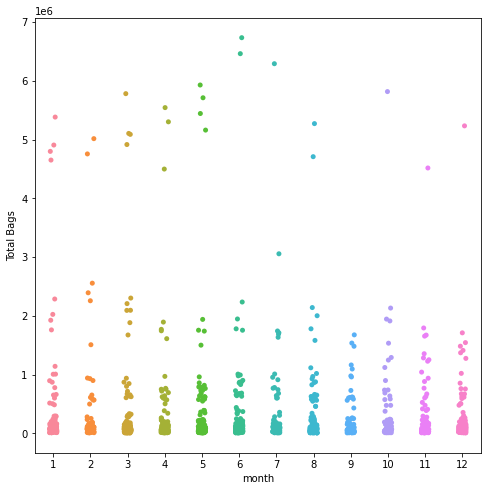

In [553]:
plt.figure(figsize=(8,8))
sns.stripplot(y='Total Bags',x='month',data=Avocado)

Total number of bags are more in month of june and july.

<AxesSubplot:xlabel='Small Bags', ylabel='Total Bags'>

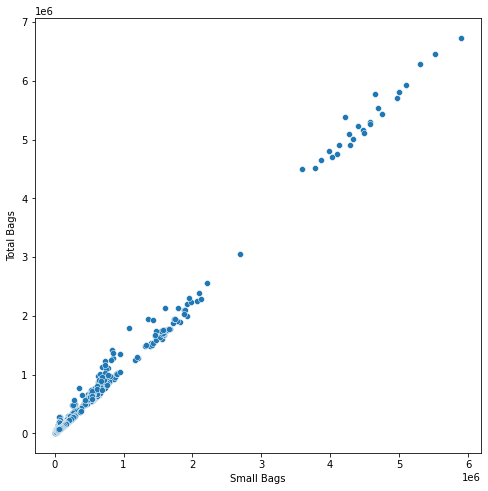

In [554]:
plt.figure(figsize=(8,8))
sns.scatterplot(y='Total Bags',x='Small Bags',data=Avocado)

Small Bags and Total bags are very positively correlated.

<AxesSubplot:xlabel='XLarge Bags', ylabel='Total Bags'>

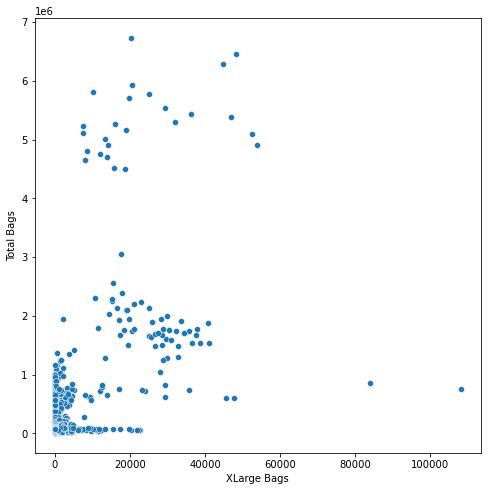

In [555]:
plt.figure(figsize=(8,8))
sns.scatterplot(y='Total Bags',x='XLarge Bags',data=Avocado)

Total Bags and XLarge bags dont share any correlation.

<AxesSubplot:xlabel='Large Bags', ylabel='Total Bags'>

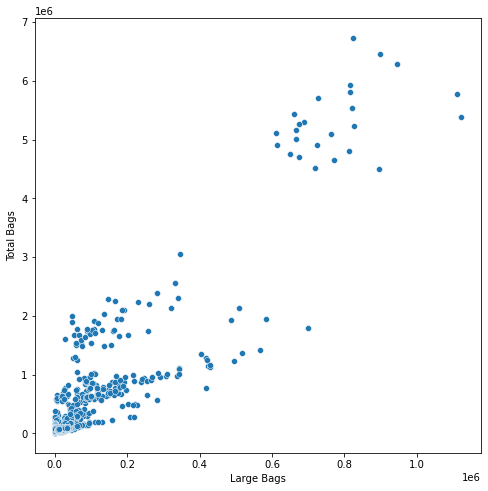

In [556]:
plt.figure(figsize=(8,8))
sns.scatterplot(y='Total Bags',x='Large Bags',data=Avocado)

Total bags and Large bags share positive correlation.

<AxesSubplot:xlabel='AveragePrice', ylabel='Total Bags'>

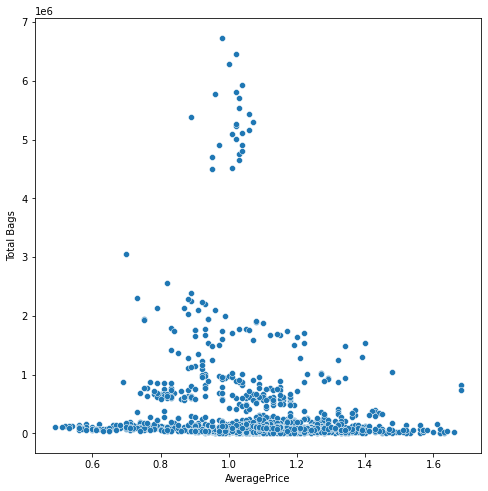

In [557]:
plt.figure(figsize=(8,8))
sns.scatterplot(y='Total Bags',x='AveragePrice',data=Avocado)

Avergae price and Total volume are not correlated.

### Multivariate Analysis

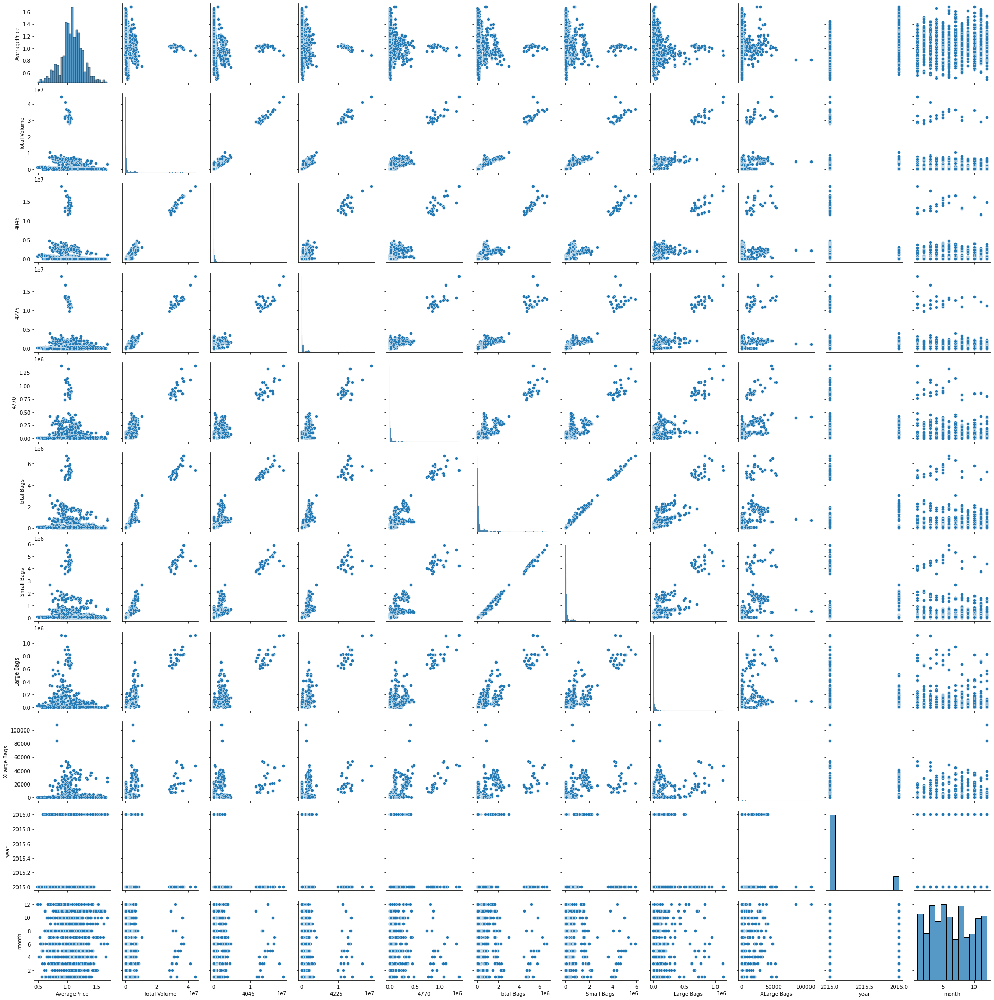

In [558]:
sns.pairplot(Avocado)

## ENCODING

In [559]:
#Apply ordinal encoding for column 
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import OneHotEncoder

In [560]:
#OE=OrdinalEncoder()

##### Drop the column type as it has constant factor conventional.

In [561]:
Avocado.drop('type',axis=1,inplace=True)

##### Apply ordinal encoding for region column

In [562]:
#Avocado['region']=OE.fit_transform(Avocado['region'].values.reshape(-1,1))

In [563]:
#Avocado

##### Region is now numerical column

In [564]:
#Avocado.region.unique()

##### There are total 50 regions in the dataset.

###### We will try One Hot Encoder as our model performance is not improving even after droping Total Volume, Total Bags which are hihgly correlated columns to most of the columns.

In [565]:
OHC=OneHotEncoder(handle_unknown='ignore', sparse=False)

In [566]:
Avocado = pd.get_dummies(data=Avocado, columns=['region'])

In [567]:
Avocado

,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,year,month,region_Albany,region_Atlanta,region_BaltimoreWashington,region_Boise,region_Boston,region_BuffaloRochester,region_California,region_Charlotte,region_Chicago,region_Columbus,region_DallasFtWorth,region_Denver,region_Detroit,region_GrandRapids,region_GreatLakes,region_HarrisburgScranton,region_HartfordSpringfield,region_Houston,region_Indianapolis,region_Jacksonville,region_LasVegas,region_LosAngeles,region_Louisville,region_MiamiFtLauderdale,region_Midsouth,region_Nashville,region_NewYork,region_Northeast,region_NorthernNewEngland,region_Orlando,region_Philadelphia,region_PhoenixTucson,region_Pittsburgh,region_Plains,region_Portland,region_RaleighGreensboro,region_RichmondNorfolk,region_Roanoke,region_SanDiego,region_SanFrancisco,region_Seattle,region_SouthCarolina,region_SouthCentral,region_Southeast,region_Spokane,region_StLouis,region_Syracuse,region_Tampa,region_TotalUS,region_West,region_WestTexNewMexico
0,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.00,2015,12,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.00,2015,12,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.00,2015,12,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.00,2015,6,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.00,2015,11,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,1.26,55979.78,1184.27,48067.99,43.61,6683.91,6556.47,127.44,0.00,2015,11,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0.99,83453.76,1368.92,73672.72,93.26,8318.86,8196.81,122.05,0.00,2015,11,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0.98,109428.33,703.75,101815.36,80.00,6829.22,6266.85,562.37,0.00,2015,8,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,1.02,99811.42,1022.15,87315.57,85.34,11388.36,11104.53,283.83,0.00,2015,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,1.07,74338.76,842.40,64757.44,113.00,8625.92,8061.47,564.45,0.00,2015,10,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


## Correlation

###### Total Bags and Small bags is highly correlated which may impact our model performance.We can consider droping Total Bags column if our model isn't performing well.

##### We drop column Total Bags as our model is not performing well.

##### We drop column Total Volume as our model is not performing well.

In [568]:
Avocado.drop('Total Bags',axis=1,inplace=True)

In [569]:
Avocado.drop('Total Volume',axis=1,inplace=True)

## OUTLIERS

In [570]:
ncols,nrows = (3,5)

In [571]:
Avocado.columns

Index(['AveragePrice', '4046', '4225', '4770', 'Small Bags', 'Large Bags',
       'XLarge Bags', 'year', 'month', 'region_Albany', 'region_Atlanta',
       'region_BaltimoreWashington', 'region_Boise', 'region_Boston',
       'region_BuffaloRochester', 'region_California', 'region_Charlotte',
       'region_Chicago', 'region_Columbus', 'region_DallasFtWorth',
       'region_Denver', 'region_Detroit', 'region_GrandRapids',
       'region_GreatLakes', 'region_HarrisburgScranton',
       'region_HartfordSpringfield', 'region_Houston', 'region_Indianapolis',
       'region_Jacksonville', 'region_LasVegas', 'region_LosAngeles',
       'region_Louisville', 'region_MiamiFtLauderdale', 'region_Midsouth',
       'region_Nashville', 'region_NewYork', 'region_Northeast',
       'region_NorthernNewEngland', 'region_Orlando', 'region_Philadelphia',
       'region_PhoenixTucson', 'region_Pittsburgh', 'region_Plains',
       'region_Portland', 'region_RaleighGreensboro', 'region_RichmondNorfolk',
   

In [572]:
CN=['AveragePrice', '4046', '4225', '4770','Small Bags', 'Large Bags', 'XLarge Bags', 'year',
       'month']

CN

['AveragePrice',
 '4046',
 '4225',
 '4770',
 'Small Bags',
 'Large Bags',
 'XLarge Bags',
 'year',
 'month']

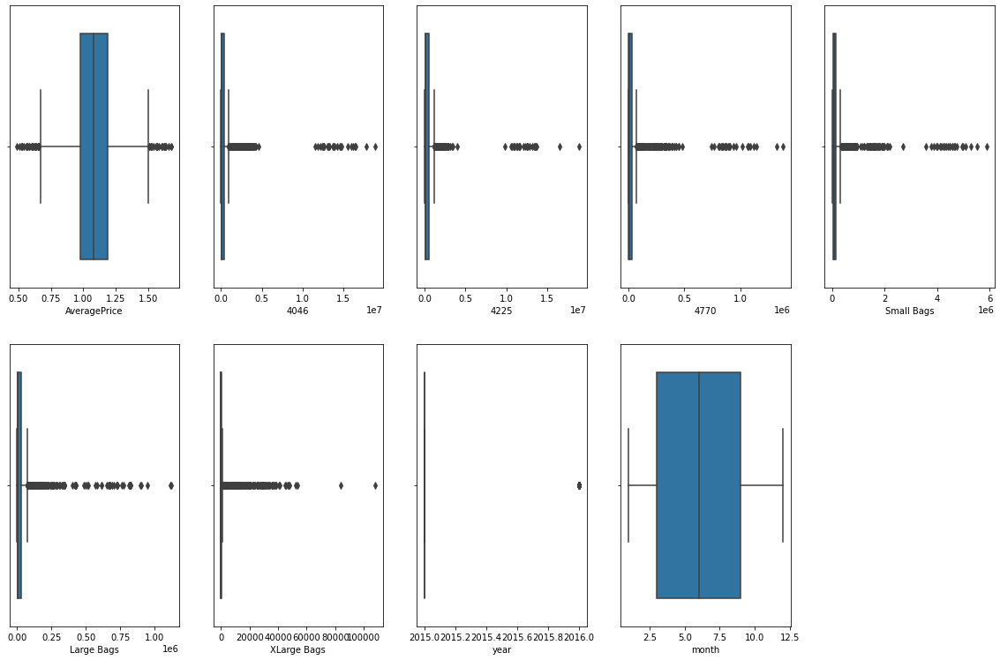

In [573]:
plt.figure(figsize=(20,20))
for index,col in enumerate(CN):
    plt.subplot(ncols,nrows,index+1)
    sns.boxplot(Avocado[CN[index]])

Observation:

We can see the presence of outliers in most of the columns.

#### Distribution Plot for skewness

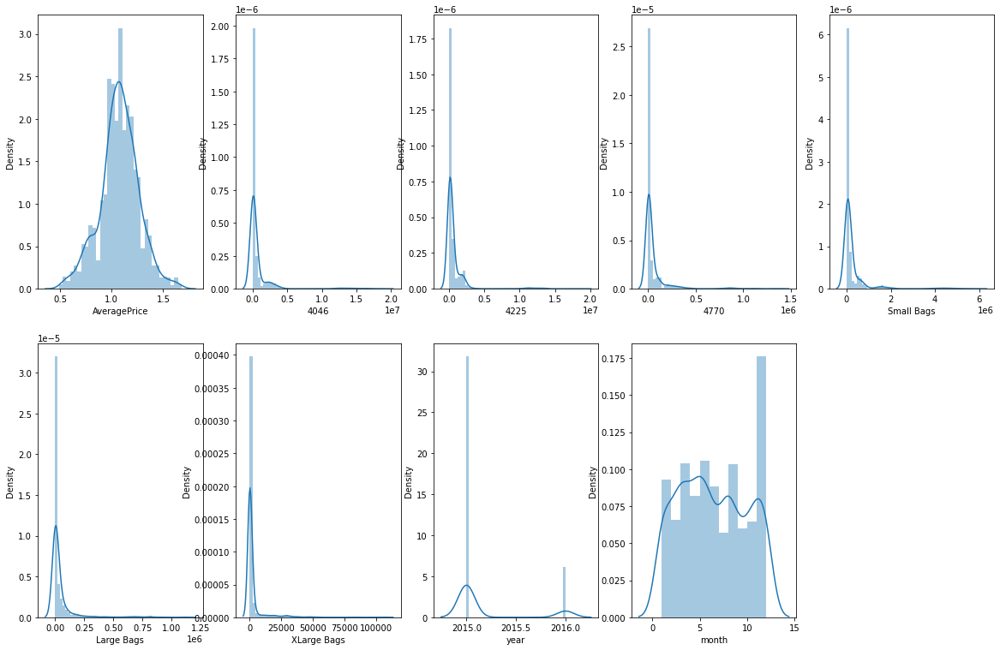

In [574]:
plt.figure(figsize=(20,20))
for index,col in enumerate(CN):
    plt.subplot(ncols,nrows,index+1)
    sns.distplot(Avocado[CN[index]])

Observation:
    
Skewness is present in most of the columns.    

## ZSCORE

Try removing the outliers through zscore method.

In [575]:
z=np.abs(zscore(Avocado))

In [576]:
threshold=3
print(np.where(z>3))

(array([   0,    1,    2, ..., 1514, 1515, 1516], dtype=int64), array([ 9,  9,  9, ..., 16, 16, 16], dtype=int64))


In [577]:
Avocado_z=Avocado[(z<3).all (axis=1)]
Avocado_z

,AveragePrice,4046,4225,4770,Small Bags,Large Bags,XLarge Bags,year,month,region_Albany,region_Atlanta,region_BaltimoreWashington,region_Boise,region_Boston,region_BuffaloRochester,region_California,region_Charlotte,region_Chicago,region_Columbus,region_DallasFtWorth,region_Denver,region_Detroit,region_GrandRapids,region_GreatLakes,region_HarrisburgScranton,region_HartfordSpringfield,region_Houston,region_Indianapolis,region_Jacksonville,region_LasVegas,region_LosAngeles,region_Louisville,region_MiamiFtLauderdale,region_Midsouth,region_Nashville,region_NewYork,region_Northeast,region_NorthernNewEngland,region_Orlando,region_Philadelphia,region_PhoenixTucson,region_Pittsburgh,region_Plains,region_Portland,region_RaleighGreensboro,region_RichmondNorfolk,region_Roanoke,region_SanDiego,region_SanFrancisco,region_Seattle,region_SouthCarolina,region_SouthCentral,region_Southeast,region_Spokane,region_StLouis,region_Syracuse,region_Tampa,region_TotalUS,region_West,region_WestTexNewMexico


In [578]:
Avocado_z.shape

(0, 60)

In [579]:
Avocado.shape

(1517, 60)

##### Using zscore method we have lost 5.3% of data which is acceptable . (81 rows)


##### Dropping the column Total Bags we lost 5.6% of data .(87 rows)

##### Dropping the column Total Volume we lost 5.6% of data .(87 rows)

##### We cannot apply zscore for dataframe after using one hot encoder as we loss all the rows.

### Quantile Method

In [584]:
AVN=['AveragePrice', '4046', '4225', '4770',
       'Small Bags', 'Large Bags', 'XLarge Bags']
AVN

['AveragePrice',
 '4046',
 '4225',
 '4770',
 'Small Bags',
 'Large Bags',
 'XLarge Bags']

###### We will initialy apply soft capping to the dataset.

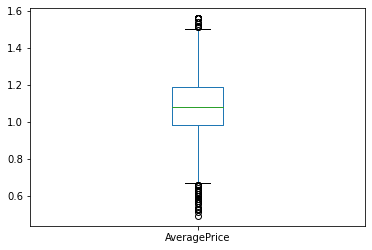

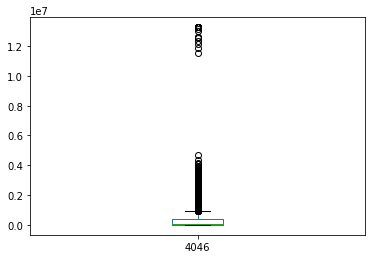

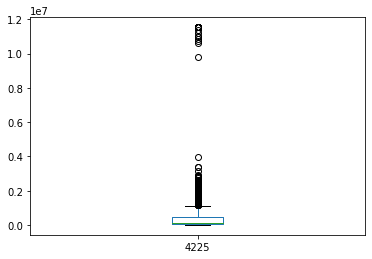

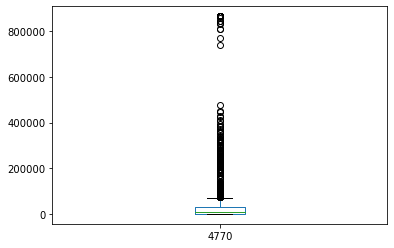

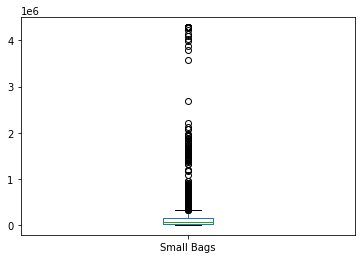

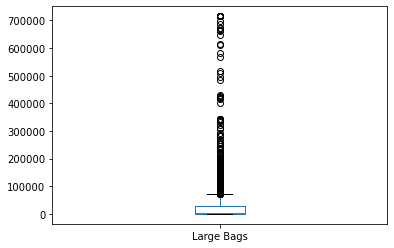

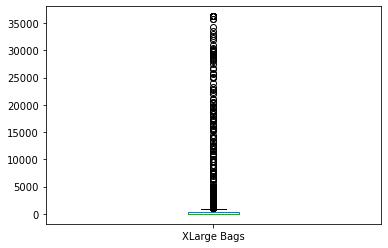

In [585]:
for i in AVN:
    
    q4=Avocado[i].quantile(0.99)
    Avocado[i][Avocado[i]>q4]=q4
    Avocado[i].plot.box()
    plt.show()

Obsrvation :

Even after soft capping there are large amount of outliers present.We apply hard capping to remove the outliers for all the columns except for Average price as more capping can tend to loose the data from this column.    

In [586]:
AVN=['4046', '4225', '4770',
       'Small Bags', 'Large Bags', 'XLarge Bags']

In [587]:
AVN

['4046', '4225', '4770', 'Small Bags', 'Large Bags', 'XLarge Bags']

#### Apply hard capping to the dataset.

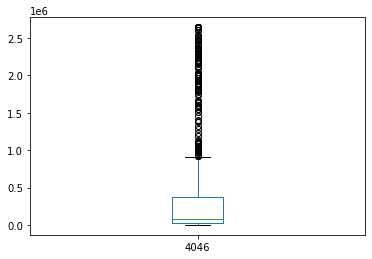

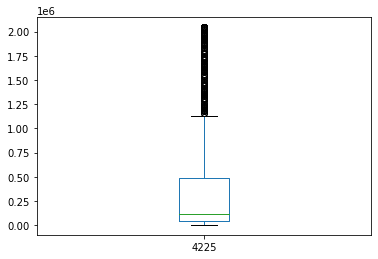

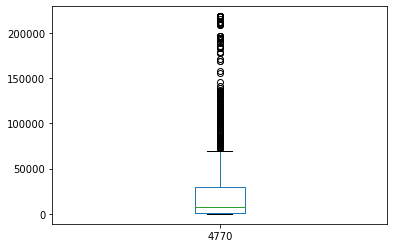

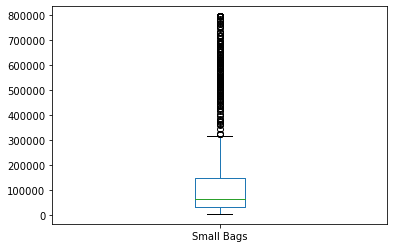

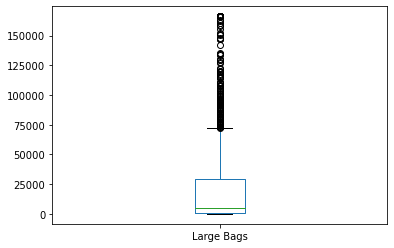

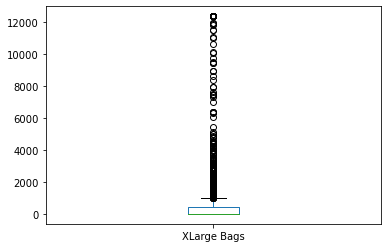

In [588]:
for i in AVN:
    
    q4=Avocado[i].quantile(0.94)
    Avocado[i][Avocado[i]>q4]=q4
    Avocado[i].plot.box()
    plt.show()

In [589]:
Avocado.describe()

,AveragePrice,4046,4225,4770,Small Bags,Large Bags,XLarge Bags,year,month,region_Albany,region_Atlanta,region_BaltimoreWashington,region_Boise,region_Boston,region_BuffaloRochester,region_California,region_Charlotte,region_Chicago,region_Columbus,region_DallasFtWorth,region_Denver,region_Detroit,region_GrandRapids,region_GreatLakes,region_HarrisburgScranton,region_HartfordSpringfield,region_Houston,region_Indianapolis,region_Jacksonville,region_LasVegas,region_LosAngeles,region_Louisville,region_MiamiFtLauderdale,region_Midsouth,region_Nashville,region_NewYork,region_Northeast,region_NorthernNewEngland,region_Orlando,region_Philadelphia,region_PhoenixTucson,region_Pittsburgh,region_Plains,region_Portland,region_RaleighGreensboro,region_RichmondNorfolk,region_Roanoke,region_SanDiego,region_SanFrancisco,region_Seattle,region_SouthCarolina,region_SouthCentral,region_Southeast,region_Spokane,region_StLouis,region_Syracuse,region_Tampa,region_TotalUS,region_West,region_WestTexNewMexico
count,1517.00000,1.517000e+03,1.517000e+03,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000
mean,1.07441,4.282070e+05,4.273480e+05,34576.543906,158336.287010,27158.459792,1276.145894,2015.162821,6.362558,0.044166,0.035597,0.042848,0.042848,0.040870,0.033619,0.050099,0.020435,0.015162,0.030982,0.011206,0.015821,0.026368,0.015162,0.011866,0.012525,0.008570,0.019117,0.010547,0.027027,0.006592,0.001978,0.022413,0.011206,0.011866,0.016480,0.029005,0.007910,0.019117,0.013843,0.008570,0.034278,0.014502,0.007910,0.019776,0.010547,0.013843,0.011206,0.025049,0.009888,0.005933,0.015821,0.025709,0.005933,0.032301,0.010547,0.012525,0.022413,0.016480,0.023731,0.017798
std,0.18727,7.596082e+05,6.204424e+05,60439.697307,227120.600013,46046.648706,3208.508244,0.369324,3.472146,0.205532,0.185343,0.202580,0.202580,0.198055,0.180306,0.218221,0.141530,0.122235,0.173327,0.105300,0.124823,0.160279,0.122235,0.108317,0.111248,0.092205,0.136980,0.102190,0.162216,0.080950,0.044441,0.148070,0.105300,0.108317,0.127354,0.167875,0.088617,0.136980,0.116878,0.092205,0.182003,0.119589,0.088617,0.139275,0.102190,0.116878,0.105300,0.156327,0.098978,0.076821,0.124823,0.158317,0.076821,0.176856,0.102190,0.111248,0.148070,0.127354,0.152260,0.132261
min,0.49000,4.677200e+02,1.783770e+03,0.000000,3311.770000,0.000000,0.000000,2015.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.98000,2.040034e+04,4.147606e+04,911.250000,29727.220000,540.740000,0.000000,2015.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1.08000,8.175117

##### Applying soft capping for AvergaePrice for Q1 as there is huge difference between min andf 25%

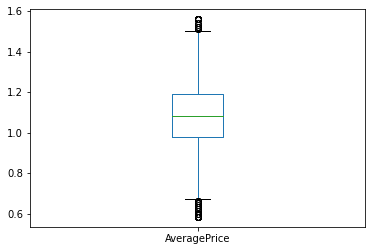

In [590]:
q1=Avocado['AveragePrice'].quantile(0.01)
Avocado['AveragePrice'][Avocado['AveragePrice']<q1]=q1
Avocado['AveragePrice'].plot.box()
plt.show()

##### Observation:
    
Avergar Price column after removing the outliers.    

In [591]:
Avocado.describe()

,AveragePrice,4046,4225,4770,Small Bags,Large Bags,XLarge Bags,year,month,region_Albany,region_Atlanta,region_BaltimoreWashington,region_Boise,region_Boston,region_BuffaloRochester,region_California,region_Charlotte,region_Chicago,region_Columbus,region_DallasFtWorth,region_Denver,region_Detroit,region_GrandRapids,region_GreatLakes,region_HarrisburgScranton,region_HartfordSpringfield,region_Houston,region_Indianapolis,region_Jacksonville,region_LasVegas,region_LosAngeles,region_Louisville,region_MiamiFtLauderdale,region_Midsouth,region_Nashville,region_NewYork,region_Northeast,region_NorthernNewEngland,region_Orlando,region_Philadelphia,region_PhoenixTucson,region_Pittsburgh,region_Plains,region_Portland,region_RaleighGreensboro,region_RichmondNorfolk,region_Roanoke,region_SanDiego,region_SanFrancisco,region_Seattle,region_SouthCarolina,region_SouthCentral,region_Southeast,region_Spokane,region_StLouis,region_Syracuse,region_Tampa,region_TotalUS,region_West,region_WestTexNewMexico
count,1517.000000,1.517000e+03,1.517000e+03,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000
mean,1.074780,4.282070e+05,4.273480e+05,34576.543906,158336.287010,27158.459792,1276.145894,2015.162821,6.362558,0.044166,0.035597,0.042848,0.042848,0.040870,0.033619,0.050099,0.020435,0.015162,0.030982,0.011206,0.015821,0.026368,0.015162,0.011866,0.012525,0.008570,0.019117,0.010547,0.027027,0.006592,0.001978,0.022413,0.011206,0.011866,0.016480,0.029005,0.007910,0.019117,0.013843,0.008570,0.034278,0.014502,0.007910,0.019776,0.010547,0.013843,0.011206,0.025049,0.009888,0.005933,0.015821,0.025709,0.005933,0.032301,0.010547,0.012525,0.022413,0.016480,0.023731,0.017798
std,0.186241,7.596082e+05,6.204424e+05,60439.697307,227120.600013,46046.648706,3208.508244,0.369324,3.472146,0.205532,0.185343,0.202580,0.202580,0.198055,0.180306,0.218221,0.141530,0.122235,0.173327,0.105300,0.124823,0.160279,0.122235,0.108317,0.111248,0.092205,0.136980,0.102190,0.162216,0.080950,0.044441,0.148070,0.105300,0.108317,0.127354,0.167875,0.088617,0.136980,0.116878,0.092205,0.182003,0.119589,0.088617,0.139275,0.102190,0.116878,0.105300,0.156327,0.098978,0.076821,0.124823,0.158317,0.076821,0.176856,0.102190,0.111248,0.148070,0.127354,0.152260,0.132261
min,0.583200,4.677200e+02,1.783770e+03,0.000000,3311.770000,0.000000,0.000000,2015.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.980000,2.040034e+04,4.147606e+04,911.250000,29727.220000,540.740000,0.000000,2015.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1.080000,8.

<AxesSubplot:>

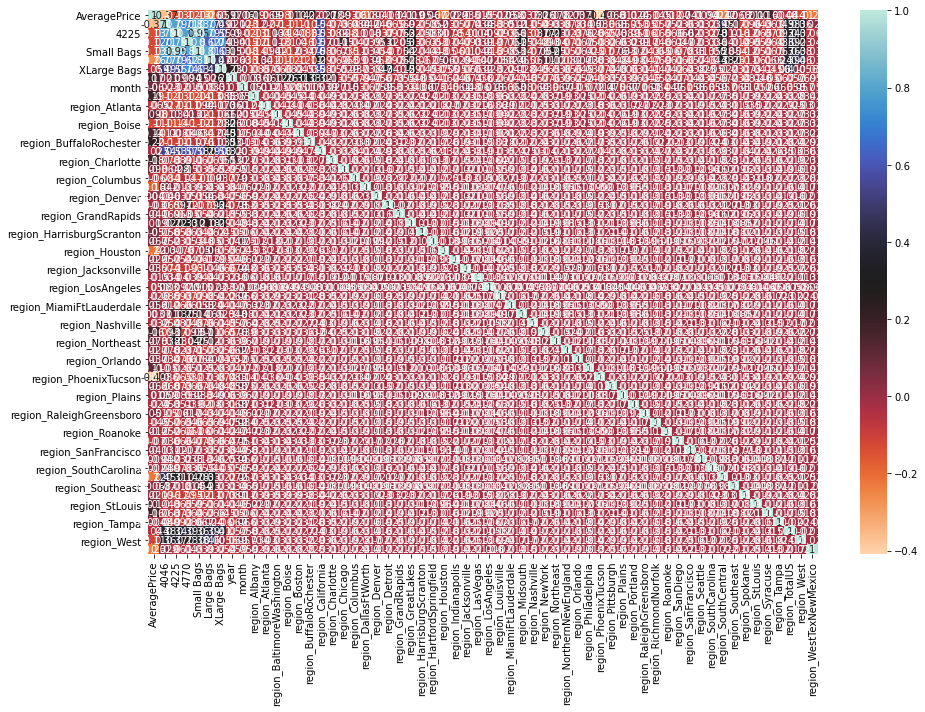

In [592]:
plt.figure(figsize=(15,10))
sns.heatmap(Avocado.corr(),annot=True,cmap='icefire_r')

## DATA SPLITING

In [593]:
x=Avocado.drop('AveragePrice',axis=1)
y=Avocado.iloc[:,0:1]

In [594]:
x

,4046,4225,4770,Small Bags,Large Bags,XLarge Bags,year,month,region_Albany,region_Atlanta,region_BaltimoreWashington,region_Boise,region_Boston,region_BuffaloRochester,region_California,region_Charlotte,region_Chicago,region_Columbus,region_DallasFtWorth,region_Denver,region_Detroit,region_GrandRapids,region_GreatLakes,region_HarrisburgScranton,region_HartfordSpringfield,region_Houston,region_Indianapolis,region_Jacksonville,region_LasVegas,region_LosAngeles,region_Louisville,region_MiamiFtLauderdale,region_Midsouth,region_Nashville,region_NewYork,region_Northeast,region_NorthernNewEngland,region_Orlando,region_Philadelphia,region_PhoenixTucson,region_Pittsburgh,region_Plains,region_Portland,region_RaleighGreensboro,region_RichmondNorfolk,region_Roanoke,region_SanDiego,region_SanFrancisco,region_Seattle,region_SouthCarolina,region_SouthCentral,region_Southeast,region_Spokane,region_StLouis,region_Syracuse,region_Tampa,region_TotalUS,region_West,region_WestTexNewMexico
0,1036.740,54454.850,48.1600,8603.620,93.2500,0.0000,2015,12,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,674.280,44638.810,58.3300,9408.070,97.4900,0.0000,2015,12,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,794.700,109149.670,130.5000,8042.210,103.1400,0.0000,2015,12,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,1132.000,71976.410,72.5800,5677.400,133.7600,0.0000,2015,6,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,941.480,43838.390,75.7800,5986.260,197.6900,0.0000,2015,11,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,1184.270,48067.990,43.6100,6556.470,127.4400,0.0000,2015,11,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,1368.920,73672.720,93.2600,8196.810,122.0500,0.0000,2015,11,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,703.750,101815.360,80.0000,6266.850,562.3700,0.0000,2015,8,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,1022.150,87315.570,85.3400,11104.530,283.8300,0.0000,2015,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,842.400,64757.440,113.0000,8061.470,564.4500,0.0000,2015,10,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [595]:
y

,AveragePrice
0,1.3300
1,1.3500
2,0.9300
3,1.0800
4,1.2800
5,1.2600
6,0.9900
7,0.9800
8,1.0200
9,1.0700


###### We will round of the dataframe x to one decimal.

In [596]:
x=x.round(1)

### Skewness

Check skewness of the dataset before running through the model.

In [597]:
x.skew()

4046                           2.111932
4225                           1.709800
4770                           2.157300
Small Bags                     1.923708
Large Bags                     2.069798
XLarge Bags                    2.832503
year                           1.828332
month                          0.101439
region_Albany                  4.441509
region_Atlanta                 5.017897
region_BaltimoreWashington     4.519249
region_Boise                   4.519249
region_Boston                  4.642517
region_BuffaloRochester        5.180052
region_California              4.128798
region_Charlotte               6.785823
region_Chicago                 7.943341
region_Columbus                5.419099
region_DallasFtWorth           9.296101
region_Denver                  7.768122
region_Detroit                 5.917882
region_GrandRapids             7.943341
region_GreatLakes              9.025011
region_HarrisburgScranton      8.775366
region_HartfordSpringfield    10.673622


All the columns have very high scale.

In [598]:
##we have droped the column Total Volume after poor perf. of model.
#x['Total Volume']=np.log(x['Total Volume'])
#x['Total Volume'].skew()

In [599]:
x['4046']=np.log(x['4046'])
x['4046'].skew()

-0.29852325212007086

In [600]:
x['4225']=np.log(x['4225'])
x['4225'].skew()

-0.02057869102767897

In [601]:
#Log and sqrt are leading the column nan hence will use power transform method
#x['4770']=np.log(x['4770'])
#x['4770'].skew()

In [602]:
#we have droped the column Total Bags after poor perf. of model.
#x['Total Bags']=np.log(x['Total Bags'])
#x['Total Bags'].skew()

In [603]:
x['Small Bags']=np.log(x['Small Bags'])
x['Small Bags'].skew()

0.33481994655191366

In [604]:
#Log and sqrt are leading the column nan hence will use power transform method
#x['Large Bags']=np.log(x['Large Bags'])
#x['Large Bags'].skew()

In [605]:
#Log and sqrt are leading the column nan hence will use power transform method
#x['XLarge Bags']=np.log(x['XLarge Bags'])
#x['XLarge Bags'].skew()

##### Importing Power tranform and method yeo-johnson to reduce skewness 

In [606]:
from sklearn.preprocessing import PowerTransformer
pt=PowerTransformer(method='yeo-johnson',standardize=True) 
X_power=pt.fit_transform(x.iloc[:,2:3])
x.iloc[:,2:3]=pd.DataFrame(X_power,columns=x.iloc[:,2:3].columns)
x.iloc[:,2:3].skew()

4770   -0.068892
dtype: float64

In [607]:
from sklearn.preprocessing import PowerTransformer
pt=PowerTransformer(method='yeo-johnson',standardize=True) 
X_power=pt.fit_transform(x.iloc[:,4:5])
x.iloc[:,4:5]=pd.DataFrame(X_power,columns=x.iloc[:,4:5].columns)
x.iloc[:,4:5].skew()

Large Bags   -0.14508
dtype: float64

In [608]:
from sklearn.preprocessing import PowerTransformer
pt=PowerTransformer(method='yeo-johnson',standardize=True) 
X_power=pt.fit_transform(x.iloc[:,5:6])
x.iloc[:,5:6]=pd.DataFrame(X_power,columns=x.iloc[:,5:6].columns)

In [609]:
x.iloc[:,5:6].skew()

XLarge Bags    0.409011
dtype: float64

###### Skewness of all the columns is now with in the range of -0.5 to 0.5 .

## SCALING

##### We will apply MInMaxScaler to treat the data x.

In [610]:
from sklearn.preprocessing import MinMaxScaler

In [611]:
scaler=MinMaxScaler()
x=pd.DataFrame(scaler.fit_transform(x),columns=x.columns)

In [612]:
x

,4046,4225,4770,Small Bags,Large Bags,XLarge Bags,year,month,region_Albany,region_Atlanta,region_BaltimoreWashington,region_Boise,region_Boston,region_BuffaloRochester,region_California,region_Charlotte,region_Chicago,region_Columbus,region_DallasFtWorth,region_Denver,region_Detroit,region_GrandRapids,region_GreatLakes,region_HarrisburgScranton,region_HartfordSpringfield,region_Houston,region_Indianapolis,region_Jacksonville,region_LasVegas,region_LosAngeles,region_Louisville,region_MiamiFtLauderdale,region_Midsouth,region_Nashville,region_NewYork,region_Northeast,region_NorthernNewEngland,region_Orlando,region_Philadelphia,region_PhoenixTucson,region_Pittsburgh,region_Plains,region_Portland,region_RaleighGreensboro,region_RichmondNorfolk,region_Roanoke,region_SanDiego,region_SanFrancisco,region_Seattle,region_SouthCarolina,region_SouthCentral,region_Southeast,region_Spokane,region_StLouis,region_Syracuse,region_Tampa,region_TotalUS,region_West,region_WestTexNewMexico
0,0.092138,0.485284,0.204117,0.174120,0.201836,0.000000,0.0,1.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.042349,0.457068,0.215885,0.190424,0.204530,0.000000,0.0,1.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.061366,0.583991,0.268442,0.161813,0.207891,0.000000,0.0,1.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.102318,0.524884,0.229759,0.098305,0.223951,0.000000,0.0,0.454545,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.080988,0.454500,0.232525,0.107968,0.249191,0.000000,0.0,0.909091,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.107546,0.467575,0.198012,0.124562,0.220884,0.000000,0.0,0.909091,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,0.124314,0.528191,0.246023,0.165286,0.218191,0.000000,0.0,0.909091,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,0.047305,0.574117,0.236001,0.116320,0.324244,0.000000,0.0,0.636364,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,0.090508,0.552308,0.240162,0.220659,0.273877,0.000000,0.0,0.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,0.068114,0.509881,0.258729,0.162250,0.324519,0.000000,0.0,0.818182,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


#### Our data is ready after applying  Encoding, Skewness testing and scaling with MinMax Scaler.

## MODEL EXECUTION

###### Check the best random_state for model running

In [613]:
maxAccu=0
maxRS=0

for i in range(1,200):
    x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=i)
    LR=LinearRegression()
    LR.fit(x_train,y_train)
    predl=LR.predict(x_test)
    ac=r2_score(y_test,predl)
    
    if ac>maxAccu:
        maxAccu=ac
        maxRS=i
        
print('Best r2_score at x is',maxAccu*100,'at random state',maxRS) 

Best r2_score at x is 75.42984620917042 at random state 183


As the Best r2_score x is 46.74468145884951 at random state 139 which is very less we will try dropping the very highly correlated columns at improve the accuracy.

As the Best r2_score is 32.77663730895027 at random state 629 which is again very less after dropping the total bags column.

As the Best r2_score is 37.43610395209323 at random state 151 which is again very less after dropping the total volume column.

As the Best r2_score is 75.42984620917042 at random state 183 which is we have found satisfactory after applying one hot encoder for region column instead of ordinal encoder.

## Linear Regresion

In [614]:
LR.coef_

array([[ 5.84645063e-02, -9.33410631e-01,  1.09430251e-01,
        -5.30953079e-01, -1.55095473e-01,  4.23477502e-02,
         6.94986207e-02,  3.53641084e-02, -4.21041547e+11,
        -4.21041547e+11, -4.21041547e+11, -4.21041547e+11,
        -4.21041547e+11, -4.21041547e+11, -4.21041547e+11,
        -4.21041547e+11, -4.21041547e+11, -4.21041547e+11,
        -4.21041547e+11, -4.21041547e+11, -4.21041547e+11,
        -4.21041547e+11, -4.21041547e+11, -4.21041547e+11,
        -4.21041547e+11, -4.21041547e+11, -4.21041547e+11,
        -4.21041547e+11, -4.21041547e+11, -4.21041547e+11,
        -4.21041547e+11, -4.21041547e+11, -4.21041547e+11,
        -4.21041547e+11, -4.21041547e+11, -4.21041547e+11,
        -4.21041547e+11, -4.21041547e+11, -4.21041547e+11,
        -4.21041547e+11, -4.21041547e+11, -4.21041547e+11,
        -4.21041547e+11, -4.21041547e+11, -4.21041547e+11,
        -4.21041547e+11, -4.21041547e+11, -4.21041547e+11,
        -4.21041547e+11, -4.21041547e+11, -4.21041547e+1

In [615]:
predl=LR.predict(x_test)

print('the predicted value :',predl)
print('The actual value:',y_test)

the predicted value : [[1.30462646]
 [1.00012207]
 [1.09082031]
 [1.23583984]
 [0.90814209]
 [1.04852295]
 [1.24353027]
 [1.30053711]
 [1.37072754]
 [0.83886719]
 [1.31768799]
 [0.97021484]
 [1.26525879]
 [0.99371338]
 [1.35437012]
 [0.82098389]
 [1.18005371]
 [1.06518555]
 [1.21942139]
 [0.95068359]
 [0.71618652]
 [1.12701416]
 [1.03747559]
 [1.1998291 ]
 [1.0189209 ]
 [1.28448486]
 [1.28045654]
 [1.30065918]
 [1.22924805]
 [0.94586182]
 [1.25384521]
 [1.25488281]
 [1.13525391]
 [1.20172119]
 [1.05999756]
 [0.80175781]
 [1.2434082 ]
 [1.13372803]
 [1.00390625]
 [0.69348145]
 [1.25469971]
 [0.91973877]
 [1.09881592]
 [1.08929443]
 [1.01251221]
 [0.9130249 ]
 [1.29284668]
 [1.06732178]
 [0.85101318]
 [1.09118652]
 [1.14611816]
 [1.24334717]
 [1.14892578]
 [0.91894531]
 [1.24072266]
 [0.92895508]
 [1.25067139]
 [1.02539062]
 [1.21716309]
 [1.13464355]
 [0.97521973]
 [0.95184326]
 [1.06359863]
 [1.00549316]
 [0.76721191]
 [0.93756104]
 [1.13934326]
 [1.00964355]
 [1.32568359]
 [0.73522949

In [616]:
print('error')

print('Mean absolute error',mean_absolute_error(y_test,predl))
print('Mean squared error',mean_squared_error(y_test,predl))


print('Root mean squared error',np.sqrt(mean_squared_error(y_test,predl)))

error
Mean absolute error 0.07697063245271381
Mean squared error 0.010068434765220648
Root mean squared error 0.10034159040607563


Root Mean Squared Error is 0.10034159040607563 which is low and r2_score is 75.42% whcich is good.So we can say our model is performing well .

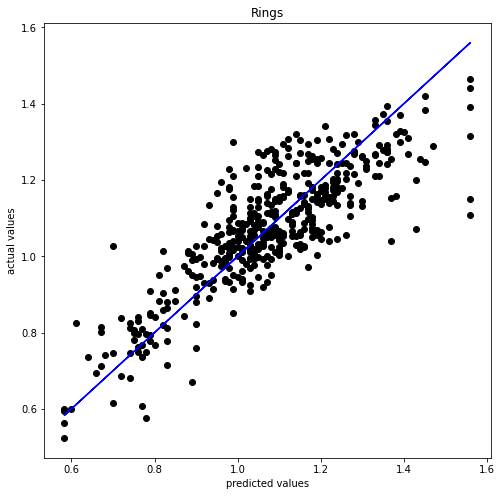

In [617]:
plt.figure(figsize=(8,8))
plt.scatter(x=y_test,y=predl,color='k')
plt.plot(y_test,y_test,color='b')
plt.xlabel('predicted values')
plt.ylabel('actual values')
plt.title('Rings')
plt.show()

### Hyper Parameter Tunning for Linear Regression Model

In [618]:
from sklearn.model_selection import GridSearchCV

model =LinearRegression()
parameters = {'fit_intercept':[True,False], 'normalize':[True,False], 'copy_X':[True, False]}
grid = GridSearchCV(model,parameters, cv=5)
grid.fit(x_train,y_train)
grid.best_params_

{'copy_X': True, 'fit_intercept': True, 'normalize': False}

After hyper parameter we have found these are best parameters ---->'copy_X': True, 'fit_intercept': True, 'normalize': True

In [619]:
predx=grid.predict(x_test)
R2_score=r2_score(y_test,predx)
R2_score

0.6965229821170209

R2_score for best parameters using linear regression model is 69.65%.

In [620]:
print('Error')

print('Mean absolute error',mean_absolute_error(y_test,predx))
print('Mean squared error',mean_squared_error(y_test,predx))


print('Root mean squared error',np.sqrt(mean_squared_error(y_test,predx)))

Error
Mean absolute error 0.07697063245271381
Mean squared error 0.010068434765220648
Root mean squared error 0.10034159040607563


##### Applying hyper parameter tunning for lasso regularization our score is 69.65%.

Also MAE,MSE and RMSE are:
    
Mean absolute error 0.07697063245271381

Mean squared error 0.010068434765220648

Root mean squared error 0.10034159040607563

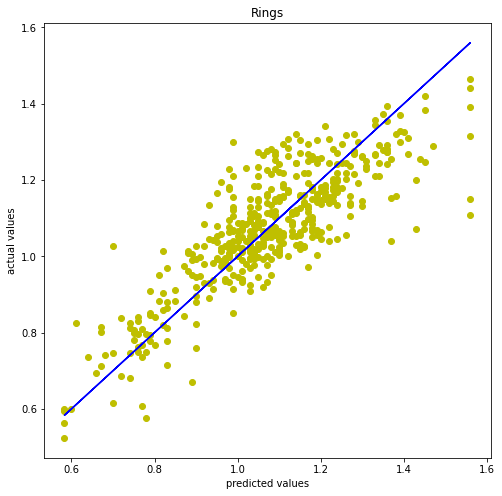

In [621]:
plt.figure(figsize=(8,8))
plt.scatter(x=y_test,y=predx,color='y')
plt.plot(y_test,y_test,color='b')
plt.xlabel('predicted values')
plt.ylabel('actual values')
plt.title('Rings')
plt.show()

## Regularization

In [622]:
from sklearn.linear_model import Lasso,Ridge,ElasticNet

### Lasso

In [623]:
from sklearn.model_selection import GridSearchCV
ls=Lasso()
param= {'alpha':[0.0001,0.001,0.01,0.05,0.1,0.2,0.4,0.6,0.8,1.0,2.0,5.0,10.0,100.0]}

model_cvls=GridSearchCV(estimator=ls,param_grid=param,scoring='neg_mean_absolute_error',cv=9,return_train_score=True,verbose=1)

model_cvls.fit(x_train,y_train)
model_cvls.best_params_

Fitting 9 folds for each of 14 candidates, totalling 126 fits


{'alpha': 0.0001}

In [624]:
ls=Lasso(alpha=0.0001)
ls.fit(x_train,y_train)
ls.score(x_train,y_train)
pred_ls=ls.predict(x_test)
print('The r2_score using lasso is:',r2_score(y_test,pred_ls)*100)

The r2_score using lasso is: 68.31629722880118


The r2_score using lasso is: 68.31629722880118

In [625]:
print('Error')

print('Mean absolute error',mean_absolute_error(y_test,pred_ls))
print('Mean squared error',mean_squared_error(y_test,pred_ls))


print('Root mean squared error',np.sqrt(mean_squared_error(y_test,pred_ls)))

Error
Mean absolute error 0.07812272139018757
Mean squared error 0.01051167883149111
Root mean squared error 0.10252647868473348


##### Applying hyper parameter tunning for lasso regularization our score is 68.31%.

Also MAE,MSE and RMSE are:

Mean absolute error 0.07812272139018757

Mean squared error 0.01051167883149111

Root mean squared error 0.10252647868473348

In [626]:
ls.coef_

array([ 0.        , -0.48697038,  0.07192054, -0.29248788, -0.14182485,
        0.03278184,  0.05472007,  0.04310054, -0.02574926, -0.12880669,
        0.17759127, -0.49981864,  0.16953067,  0.07282469,  0.22113727,
        0.0771752 ,  0.18442722, -0.27974702, -0.20040217,  0.10580194,
       -0.16918534,  0.        ,  0.31893106,  0.04807875,  0.084797  ,
       -0.17782395, -0.        , -0.1599004 , -0.08649014, -0.00638654,
       -0.21461701,  0.04029435,  0.20719926, -0.28697914,  0.41088578,
        0.53809305,  0.02830575, -0.03732136,  0.29863903, -0.39548077,
       -0.        ,  0.07890008, -0.04724026, -0.        , -0.2035816 ,
       -0.07667132, -0.11574533,  0.15257815, -0.03351054, -0.06353291,
        0.03961684,  0.17144701, -0.22745265,  0.05343555,  0.06447062,
       -0.05028519,  0.2607635 ,  0.18248429, -0.28341827])

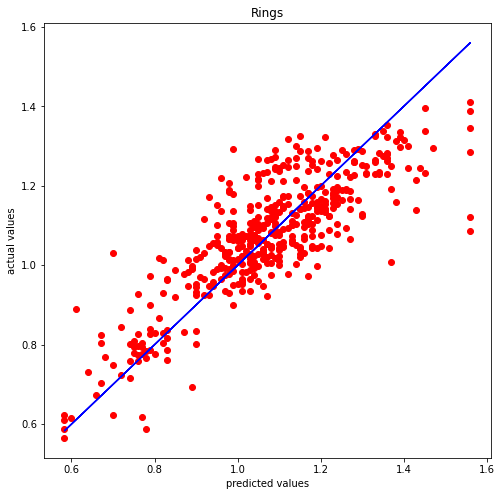

In [627]:
plt.figure(figsize=(8,8))
plt.scatter(x=y_test,y=pred_ls,color='r')
plt.plot(y_test,y_test,color='b')
plt.xlabel('predicted values')
plt.ylabel('actual values')
plt.title('Rings')
plt.show()

### RIDGE

In [628]:
from sklearn.model_selection import GridSearchCV
rd=Ridge()
param= {'alpha':[0.0001,0.001,0.01,0.05,0.1,0.2,0.4,0.6,0.8,1.0,2.0,5.0,10.0,100.0]}

model_cvrd=GridSearchCV(estimator=rd,param_grid=param,scoring='neg_mean_absolute_error',cv=7,return_train_score=True,verbose=1)

model_cvrd.fit(x_train,y_train)

model_cvrd.best_params_

Fitting 7 folds for each of 14 candidates, totalling 98 fits


{'alpha': 0.0001}

In [629]:
rd=Ridge(alpha=0.0001) #rd=ridge
rd.fit(x_train,y_train)
rd.score(x_train,y_train)
pred_rd=rd.predict(x_test)
print('The r2_score using ridge is:',r2_score(y_test,pred_rd)*100)

The r2_score using ridge is: 69.82865508843562


##### The r2_score using ridge is: 69.82865508843562

In [630]:
print('Error')

print('Mean absolute error',mean_absolute_error(y_test,pred_rd))
print('Mean squared error',mean_squared_error(y_test,pred_rd))


print('Root mean squared error',np.sqrt(mean_squared_error(y_test,pred_rd)))

Error
Mean absolute error 0.07667793229207327
Mean squared error 0.010009924973567346
Root mean squared error 0.10004961256080579


In [631]:
rd.coef_

array([[ 0.05851352, -0.93309151,  0.10978008, -0.5351954 , -0.15226999,
         0.04292081,  0.07131338,  0.03463085, -0.14114793, -0.23556465,
         0.28249023, -0.78767129,  0.25432712,  0.02812587,  0.42885598,
        -0.01812272,  0.27265376, -0.4577379 , -0.1813356 ,  0.16605425,
        -0.27238265, -0.01918875,  0.5350002 ,  0.04288175,  0.12432058,
        -0.13366155, -0.0703707 , -0.37633247, -0.14660044,  0.03941784,
        -0.35629837, -0.04646214,  0.39341253, -0.51952893,  0.60248822,
         0.82034448,  0.09594997, -0.18410666,  0.36718676, -0.39669345,
        -0.11360086,  0.19249149, -0.02950784, -0.07097447, -0.28533611,
        -0.19325328, -0.14678232,  0.22740656, -0.01970841, -0.16770225,
         0.24878018,  0.26801258, -0.40835476, -0.04136129, -0.05041017,
        -0.12895627,  0.49384753,  0.41335591, -0.29824961]])

##### Applying hyper parameter tunning for ridge regularization our score is 69.28%.


Also MAE,MSE and RMSE are:
    
Mean absolute error 0.07667793229207327

Mean squared error 0.010009924973567346

Root mean squared error 0.10004961256080579

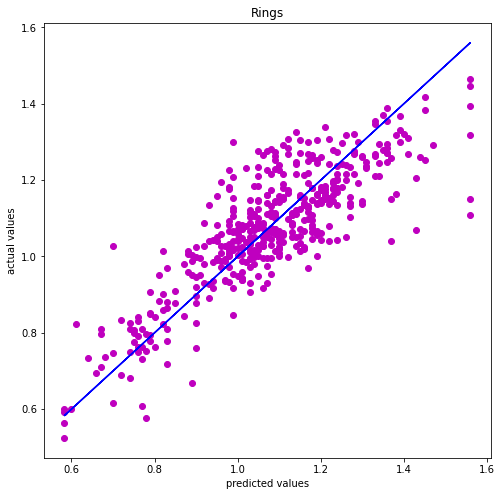

In [632]:
plt.figure(figsize=(8,8))
plt.scatter(x=y_test,y=pred_rd,color='m')
plt.plot(y_test,y_test,color='b')
plt.xlabel('predicted values')
plt.ylabel('actual values')
plt.title('Rings')
plt.show()

## Random Forest Regressor

In [633]:
from sklearn.ensemble import RandomForestRegressor
rdr = RandomForestRegressor()
rdr.fit(x_train,y_train)
predrdr=rdr.predict(x_test)
print('The r2_score using ridge is:',r2_score(y_test,predrdr)*100)

The r2_score using ridge is: 81.80098883863404


In [634]:
print('error')

print('Mean absolute error',mean_absolute_error(y_test,predrdr))
print('Mean squared error',mean_squared_error(y_test,predrdr))


print('Root mean squared error',np.sqrt(mean_squared_error(y_test,predrdr)))

error
Mean absolute error 0.05781178738512945
Mean squared error 0.006037872585804549
Root mean squared error 0.07770374885296429


We are getting much lesser Root mean squared error ,mean squared error and mean absolute error for random forest regressor model compared to other models.

R2_score for random forest regressor model is 81.99% which is also better than other models.

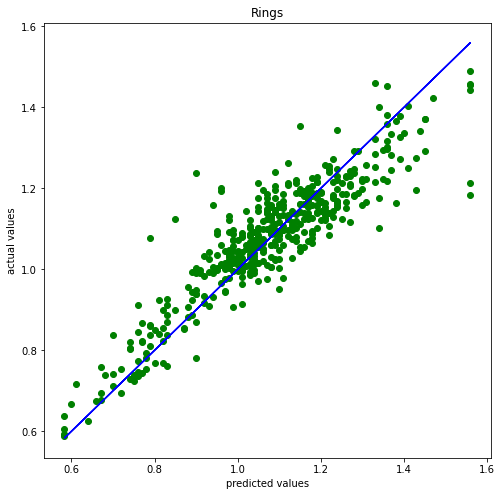

In [635]:
plt.figure(figsize=(8,8))
plt.scatter(x=y_test,y=predrdr,color='g')
plt.plot(y_test,y_test,color='b')
plt.xlabel('predicted values')
plt.ylabel('actual values')
plt.title('Rings')
plt.show()

### Hyperparameter Tunning for Random Forest Regressor

In [636]:
%%time
modelr =RandomForestRegressor()
parameters = {
    
    'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100],
 'max_features': ['auto', 'sqrt'],
 'min_samples_leaf': [1, 2, 4],
 'min_samples_split': [2, 5, 10]
             }

gridrfr = GridSearchCV(modelr,parameters,cv=7)
gridrfr.fit(x_train,y_train)
gridrfr.best_params_

Wall time: 5min 26s


{'max_depth': 90,
 'max_features': 'auto',
 'min_samples_leaf': 1,
 'min_samples_split': 2}

In [649]:
predrfr=gridrfr.predict(x_test)
R2_score=r2_score(y_test,predrfr)
print('The R2_score for cv=7 is :',(R2_score*100))

The R2_score for cv=7 is : 81.57787509787444


The R2_score for cv=3 is : 81.83144540427203
    
The R2_score for cv=5 is : 81.25587186133866
    
The R2_score for cv=7 is : 82.07027648618022
    
The R2_score for cv=9 is : 81.53283827481708    

In [638]:
print('Error')

print('Mean absolute error',mean_absolute_error(y_test,predrfr))
print('Mean squared error',mean_squared_error(y_test,predrfr))


print('Root mean squared error',np.sqrt(mean_squared_error(y_test,predrfr)))

Error
Mean absolute error 0.058131187030075124
Mean squared error 0.006111894867944164
Root mean squared error 0.0781786087618868


###### After Hyper parameter tunning of random forest classifier our score has improved from 81.995 to 82.07%.

Also MAE,MSE and RMSE have reduced :

Mean absolute error ---> 0.05723278874269001   

Mean squared error ----> 0.005948531220474409  

Root mean squared error ---> 0.07712672183150537

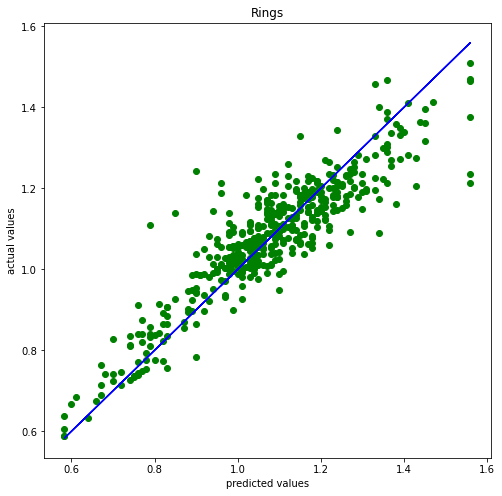

In [639]:
plt.figure(figsize=(8,8))
plt.scatter(x=y_test,y=predrfr,color='g')
plt.plot(y_test,y_test,color='b')
plt.xlabel('predicted values')
plt.ylabel('actual values')
plt.title('Rings')
plt.show()

## XGBoost Regressor Model

In [640]:
XGB = XGBRegressor()
XGB.fit(x_train,y_train)
pred_xgb=XGB.predict(x_test)
print('The r2_score using ridge is:',r2_score(y_test,pred_xgb)*100)

The r2_score using ridge is: 81.22514829289598


In [641]:
print('Error')

print('Mean absolute error',mean_absolute_error(y_test,pred_xgb))
print('Mean squared error',mean_squared_error(y_test,pred_xgb))
print('Root mean squared error',np.sqrt(mean_squared_error(y_test,pred_xgb)))

Error
Mean absolute error 0.056745173457630894
Mean squared error 0.006228918781341121
Root mean squared error 0.07892349955077461


We are getting lesser Root mean squared error ,mean squared error and mean absolute error for XGBoost Regressor model compared to other models but higher than random forest regressor model.

R2_score for random forest regressor model is 81.22% which is also better than other models but higher than ramdom forest regressor model.

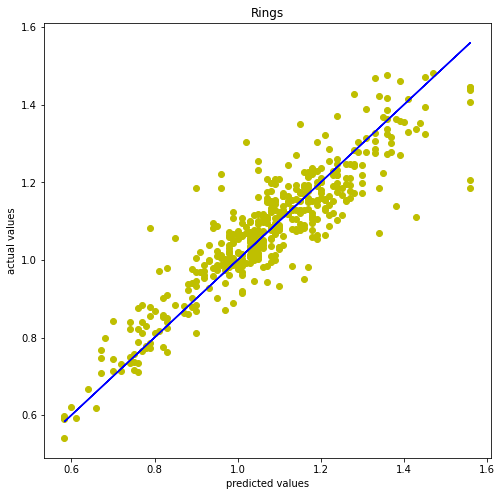

In [642]:
plt.figure(figsize=(8,8))
plt.scatter(x=y_test,y=pred_xgb,color='y')
plt.plot(y_test,y_test,color='b')
plt.xlabel('predicted values')
plt.ylabel('actual values')
plt.title('Rings')
plt.show()

### Hyperparameter Tunning for XGBoost Regressor

In [643]:
modelx =XGBRegressor()
parameters = {'max_depth':[1,4,6,10],'eta':[0.001,0.01,0.3,0.2],'subsample':[0.2,0.5,0.6]}
gridx = GridSearchCV(modelx,parameters,cv=3)
gridx.fit(x_train,y_train)
gridx.best_params_

{'eta': 0.2, 'max_depth': 10, 'subsample': 0.6}

In [644]:
predxg=gridx.predict(x_test)
R2_score=r2_score(y_test,predxg)
print('The R2_score for cv=3 is :',(R2_score*100))

The R2_score for cv=3 is : 82.92552017208527


The R2_score for cv=5 is : 79.84684464911359

The R2_score for cv=7 is : 80.39090876832233   
    
The R2_score for cv=3 is : 82.92552017208527   

##### Hence will consider cross folds 3 for running the model.

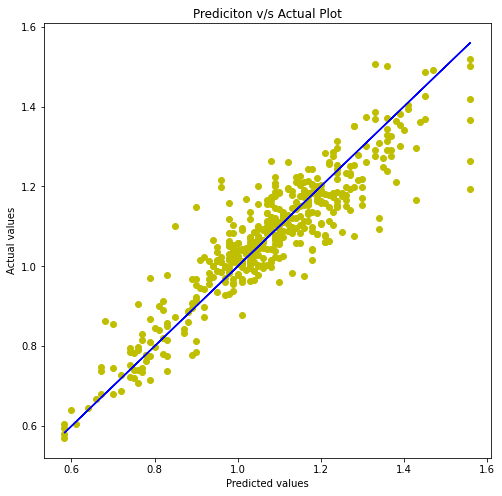

In [645]:
plt.figure(figsize=(8,8))
plt.scatter(x=y_test,y=predxg,color='y')
plt.plot(y_test,y_test,color='b')
plt.xlabel('Predicted values')
plt.ylabel('Actual values')
plt.title('Prediciton v/s Actual Plot')
plt.show()

In [646]:
print('error')

print('Mean absolute error',mean_absolute_error(y_test,predxg))
print('Mean squared error',mean_squared_error(y_test,predxg))
print('Root mean squared error',np.sqrt(mean_squared_error(y_test,predxg)))

error
Mean absolute error 0.05492520591668915
Mean squared error 0.005664787650039621
Root mean squared error 0.075264783597906


###### Predicted and Actual values

In [647]:
print('the predicted value :',predxg[:5])
print('The actual value:',y_test[:5])

the predicted value : [1.2253383  0.97854435 1.093807   1.2505709  0.9711208 ]
The actual value:       AveragePrice
1426          1.15
902           1.00
914           1.06
693           1.27
857           0.79


###### After Hyper parameter tunning of XgBoost Classifier our score has improved from 81.22 to 82.92%.

Also MAE,MSE and RMSE have reduced :

Mean absolute error 0.05492520591668915

Mean squared error 0.005664787650039621

Root mean squared error 0.075264783597906

### Conclusion:

#### After running the the different models we can understand that XGBoost Regressor model is the best model supporting our dataset, with R2_score of 82.9% which is best from all the models.

#### Even we get the least root mean squared error and mean squred error for this model (MSM: 0.005 and RMSE: 0.07)

## JOBLIB

In [648]:
joblib.dump(modelx,'Avocado.obj')

['Avocado.obj']